In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as stats
plt.style.use('ggplot')

In [2]:
PM_19 = pd.read_csv("../PM_2019_by_week.csv", sep=';')
PM_20 = pd.read_csv("../PM_2020_by_week.csv", sep=';')

PM_19['Тональность текста'] = PM_19['Тональность слов (по усредненным значениям)'] / PM_19['Число слов']
PM_20['Тональность текста'] = PM_20['Тональность слов (по усредненным значениям)'] / PM_20['Число слов']

In [3]:
sources = list(PM_19.source.unique())
week_nums = [i for i in range(18)]
features = ['item_count'] + PM_19.columns[6:].to_list()
text_types = ['posts','comments']

dates = []
for i in week_nums:
    timespan = PM_19.date_start.unique()[i][-5:].replace('-','.') + " - " + PM_19.date_end.unique()[i][-5:].replace('-','.')
    dates.append(timespan)

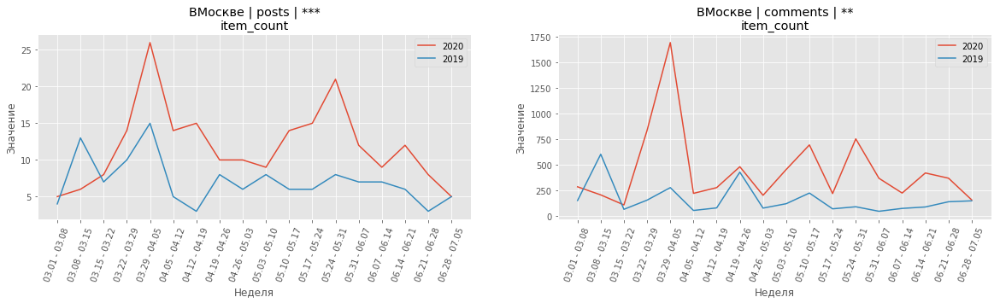

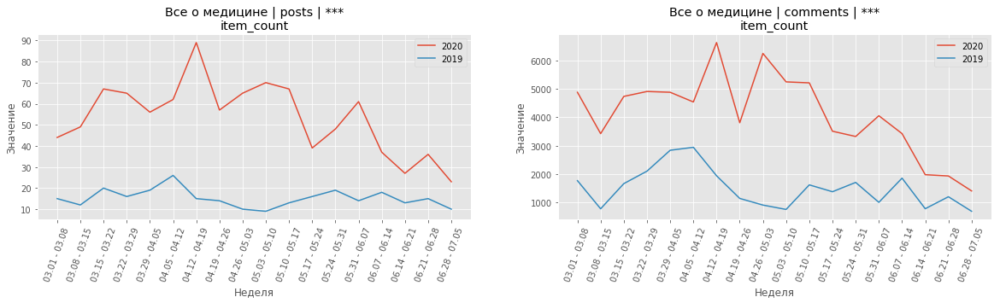

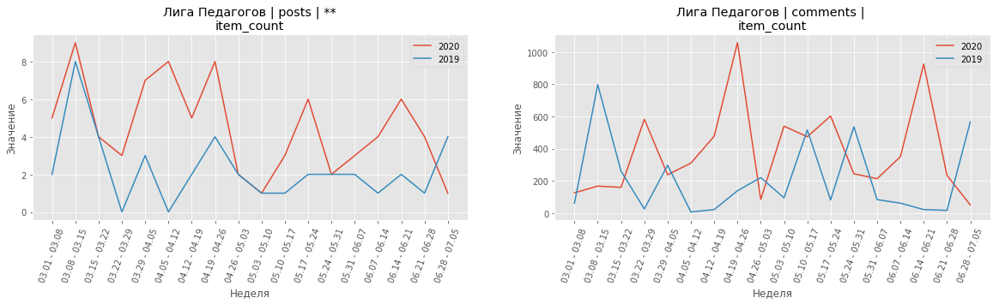

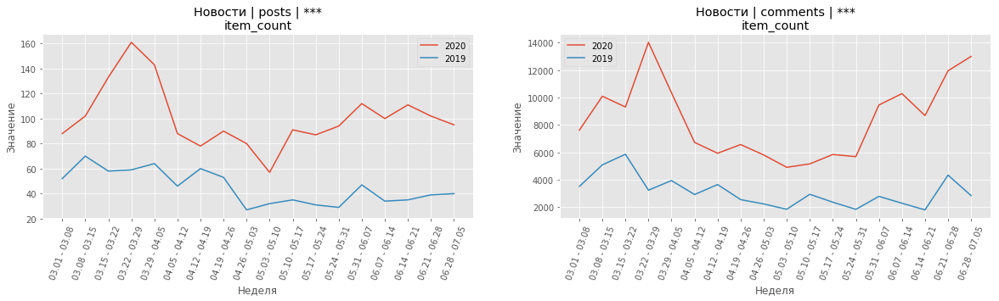

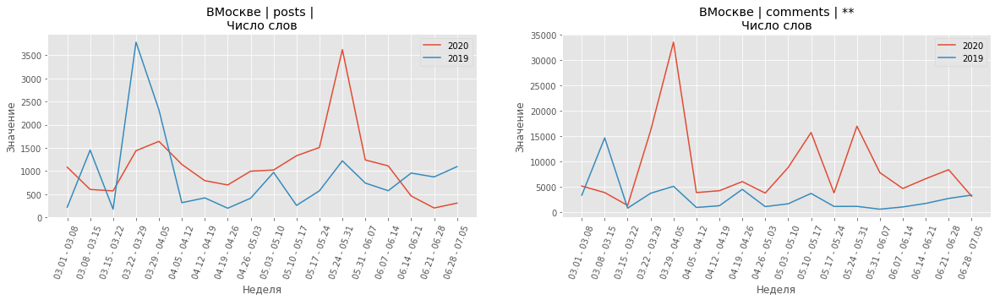

...

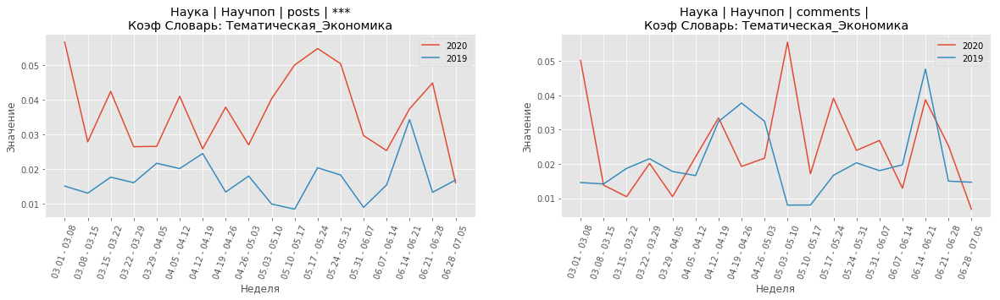

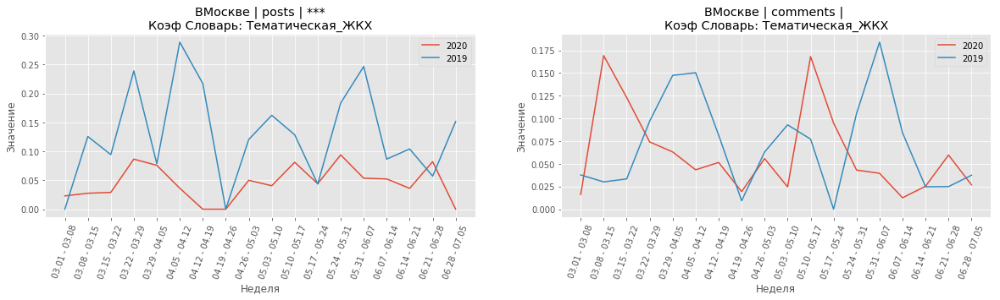

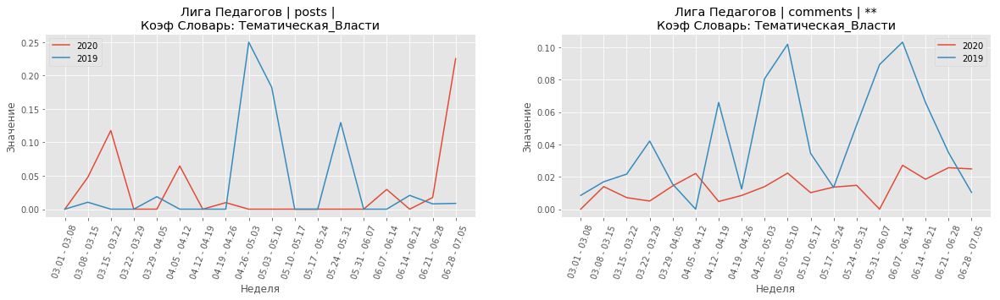

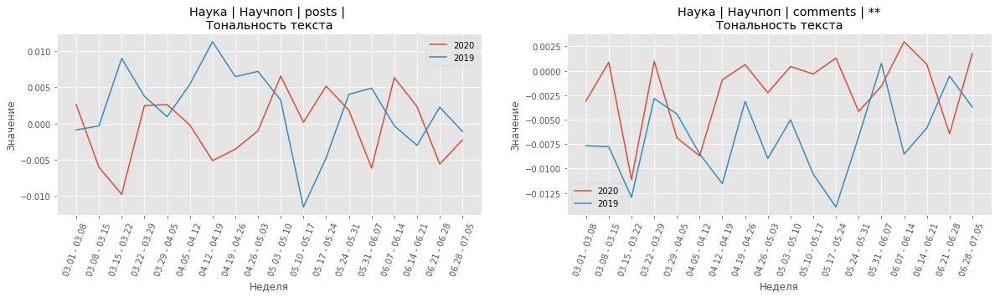

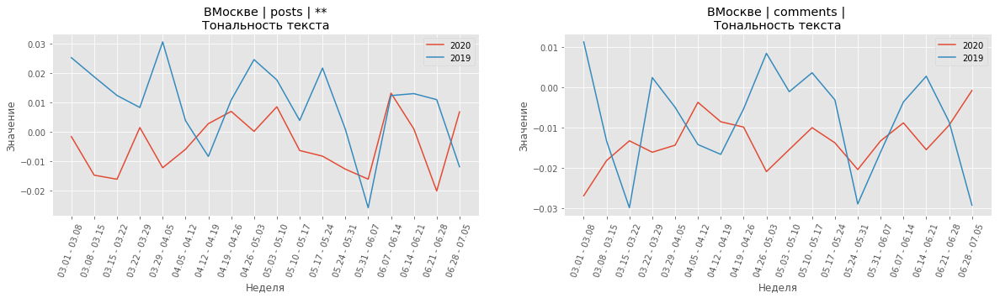

In [4]:
for feature in features:
    for source in sources:
        
        target_20_posts = PM_20.loc[(PM_20['source']==source) & (PM_20['text_type']=='posts') & (PM_20['source']==source),('date_end',feature)]
        target_19_posts = PM_19.loc[(PM_19['source']==source) & (PM_19['text_type']=='posts') & (PM_19['source']==source),('date_end',feature)]
        s_posts,p_posts = stats.ttest_rel(target_19_posts[feature], target_20_posts[feature])


        target_20_comments = PM_20.loc[(PM_20['source']==source) & (PM_20['text_type']=='comments') & (PM_20['source']==source),('date_end',feature)]
        target_19_comments = PM_19.loc[(PM_19['source']==source) & (PM_19['text_type']=='comments') & (PM_19['source']==source),('date_end',feature)]
        s_comments,p_comments = stats.ttest_rel(target_19_comments[feature], target_20_comments[feature])

        if p_posts < 0.01 or p_comments < 0.01:
            degree = 70
            
            p_posts_text = ''
            if p_posts < 0.05:
                p_posts_text += '*'
            if p_posts < 0.01:
                p_posts_text += '*'
            if p_posts < 0.001:
                p_posts_text += '*'
            
            p_comments_text = ''
            if p_comments < 0.05:
                p_comments_text += '*'
            if p_comments < 0.01:
                p_comments_text += '*'
            if p_comments < 0.001:
                p_comments_text += '*'
                
            plt.figure(figsize=(20,4))
            
            ax = plt.subplot(121)
            plt.plot(dates, target_20_posts[feature])
            plt.plot(dates, target_19_posts[feature])
            plt.xticks(dates, rotation=degree)
            title_string = source + " | " + "posts" + ' | ' + p_posts_text + '\n'+feature
            plt.title(title_string)
            plt.ylabel("Значение")
            plt.xlabel('Неделя')
            plt.legend(['2020','2019'])
            plt.grid(True)

            ax = plt.subplot(122)
            plt.plot(dates, target_20_comments[feature])
            plt.plot(dates, target_19_comments[feature])
            plt.xticks(dates, rotation=degree)
            title_string = source + " | " + "comments" + ' | ' + p_comments_text + '\n'+feature
            plt.title(title_string)
            plt.ylabel("Значение")
            plt.xlabel('Неделя')
            plt.legend(['2020','2019'])
            plt.grid(True)

            plt.show()